<a href="https://colab.research.google.com/github/ahmadSum1/NTNU_mscThesis/blob/SAHI/SAHI_inference_for_yolov5_AFO_checkpoint.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 0. Preperation

- Install latest version of SAHI and YOLOv5:

In [1]:
!pip install -U torch sahi yolov5

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 619.9/619.9 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.0/104.0 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.3/953.3 kB 70.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.0/21.0 MB 84.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 849.3/849.3 kB 66.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 112.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 557.1/557.1 MB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.1/317.1 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.4/168.4 MB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 MB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.6/102.6 MB 8.8 MB/s eta 0:00:00
     ━━━━━

In [2]:
import os
os.getcwd()

'/content'

- Import required modules:

In [3]:
# arrange an instance segmentation model for test
from sahi.utils.yolov5 import (
    download_yolov5s6_model,
)

# import required functions, classes
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

In [4]:
import torch
device = "cpu"

if torch.cuda.is_available():
   print("Training on GPU")
   device = "cuda:0"

Training on GPU


- Download a yolov5 model and two test images:

In [5]:
# download YOLOV5S6 model to 'models/yolov5s6.pt'
yolov5_model_path = 'models/yolov5s6.pt'
download_yolov5s6_model(destination_path=yolov5_model_path)

# download test images into demo_data folder
download_from_url('https://raw.githubusercontent.com/obss/sahi/main/demo/demo_data/small-vehicles1.jpeg', 'demo_data/small-vehicles1.jpeg')
download_from_url('https://raw.githubusercontent.com/obss/sahi/main/demo/demo_data/terrain2.png', 'demo_data/terrain2.png')

In [6]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [34]:
yolov5_model_path = '/notebooks/datasets/model_backup/yolov5s_200epochs2x2_19may_best.pt'

## 1. Standard Inference with a YOLOv5 Model

- Instantiate a detection model by defining model weight path and other parameters:

In [45]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov5',
    model_path=yolov5_model_path,
    confidence_threshold=0.5,
    device= device
)

- Perform prediction by feeding the get_prediction function with an image path and a DetectionModel instance:

In [53]:
image_path = "/content/2275.jpgcolage1-.5-.25.jpg"
result = get_prediction(image_path, detection_model)
result

- Or perform prediction by feeding the get_prediction function with a numpy image and a DetectionModel instance:

In [54]:
# result = get_prediction(read_image("demo_data/small-vehicles1.jpeg"), detection_model)

- Visualize predicted bounding boxes and masks over the original image:

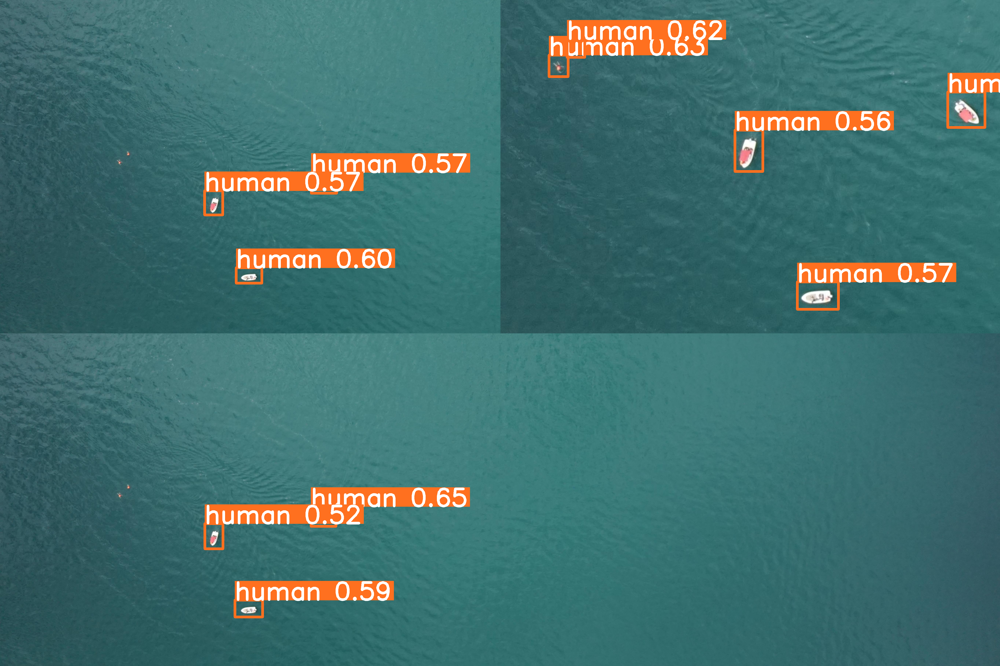

In [55]:
result.export_visuals(export_dir="./")

Image("/content/prediction_visual.png")

## 2. Sliced Inference with a YOLOv5 Model

- To perform sliced prediction we need to specify slice parameters. In this example we will perform prediction over slices of 256x256 with an overlap ratio of 0.2:

In [68]:
result = get_sliced_prediction(
    image_path,
    detection_model,
    slice_height = 1024,
    slice_width = 1024,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)

Performing prediction on 20 number of slices.


- Visualize predicted bounding boxes and masks over the original image:

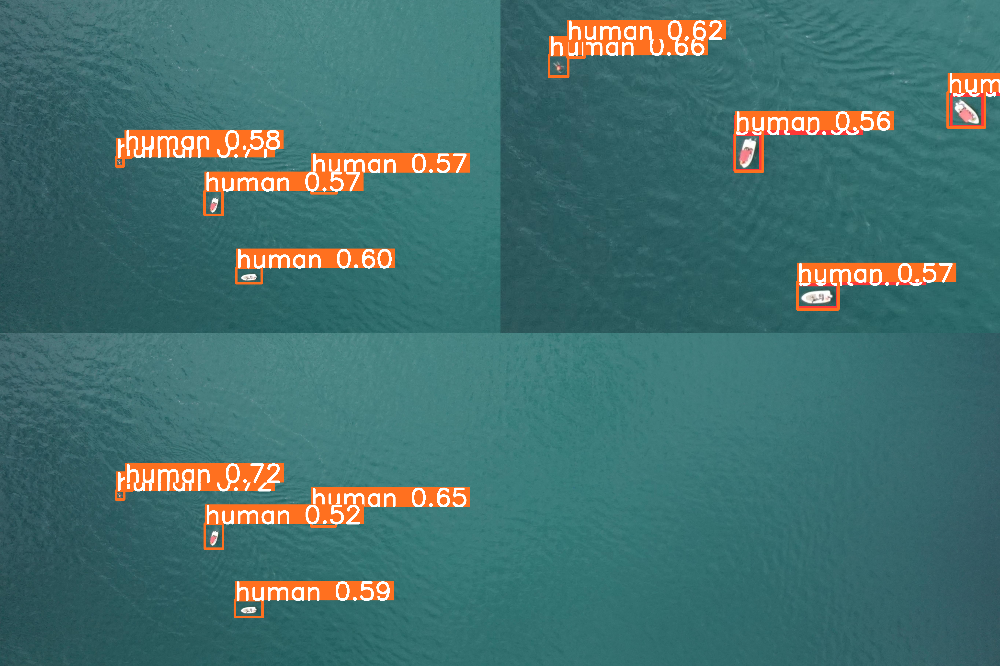

In [69]:
result.export_visuals(export_dir="yolov5_4x4tileAFO/")

Image("yolov5_4x4tileAFO/prediction_visual.png")

## 3. Prediction Result

- Predictions are returned as [sahi.prediction.PredictionResult](sahi/prediction.py), you can access the object prediction list as:

In [58]:
object_prediction_list = result.object_prediction_list

In [59]:
object_prediction_list[0]

ObjectPrediction<
    bbox: BoundingBox: <(977.7056427001953, 1109.7371215820312, 1056.9700164794922, 1156.6703186035156), w: 79.26437377929688, h: 46.933197021484375>,
    mask: None,
    score: PredictionScore: <value: 0.7298460602760315>,
    category: Category: <id: 0, name: boat>>

- ObjectPrediction's can be converted to [COCO annotation](https://cocodataset.org/#format-data) format:

In [60]:
result.to_coco_annotations()[:3]

[{'image_id': None,
  'bbox': [977.7056427001953,
   1109.7371215820312,
   79.26437377929688,
   46.933197021484375],
  'score': 0.7298460602760315,
  'category_id': 0,
  'category_name': 'boat',
  'segmentation': [],
  'iscrowd': 0,
  'area': 3720},
 {'image_id': None,
  'bbox': [978.7788696289062,
   2472.263427734375,
   75.96897888183594,
   46.128662109375],
  'score': 0.7015688419342041,
  'category_id': 0,
  'category_name': 'boat',
  'segmentation': [],
  'iscrowd': 0,
  'area': 3504},
 {'image_id': None,
  'bbox': [849.2557067871094,
   801.4606018066406,
   53.680084228515625,
   73.447265625],
  'score': 0.5919492244720459,
  'category_id': 0,
  'category_name': 'boat',
  'segmentation': [],
  'iscrowd': 0,
  'area': 3942}]

- ObjectPrediction's can be converted to [COCO prediction](https://github.com/i008/COCO-dataset-explorer) format:

In [61]:
result.to_coco_predictions(image_id=1)[:3]

[{'image_id': 1,
  'bbox': [977.7056427001953,
   1109.7371215820312,
   79.26437377929688,
   46.933197021484375],
  'score': 0.7298460602760315,
  'category_id': 0,
  'category_name': 'boat',
  'segmentation': [],
  'iscrowd': 0,
  'area': 3720},
 {'image_id': 1,
  'bbox': [978.7788696289062,
   2472.263427734375,
   75.96897888183594,
   46.128662109375],
  'score': 0.7015688419342041,
  'category_id': 0,
  'category_name': 'boat',
  'segmentation': [],
  'iscrowd': 0,
  'area': 3504},
 {'image_id': 1,
  'bbox': [849.2557067871094,
   801.4606018066406,
   53.680084228515625,
   73.447265625],
  'score': 0.5919492244720459,
  'category_id': 0,
  'category_name': 'boat',
  'segmentation': [],
  'iscrowd': 0,
  'area': 3942}]

- ObjectPrediction's can be converted to [imantics](https://github.com/jsbroks/imantics) annotation format:

In [62]:
# !pip install imantics
!pip install -U fiftyone

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [63]:
# result.to_imantics_annotations()[:3]

- ObjectPrediction's can be converted to [fiftyone](https://github.com/voxel51/fiftyone) detection format:

In [64]:
result.to_fiftyone_detections()[:3]

[<Detection: {
     'id': '646633404264423d246be106',
     'attributes': {},
     'tags': [],
     'label': 'boat',
     'bounding_box': [
         0.23916478539632957,
         0.4072429803970757,
         0.019389523918614697,
         0.017223191567517202,
     ],
     'mask': None,
     'confidence': 0.7298460602760315,
     'index': None,
 }>,
 <Detection: {
     'id': '646633404264423d246be107',
     'attributes': {},
     'tags': [],
     'label': 'boat',
     'bounding_box': [
         0.23942731644542717,
         0.9072526340309633,
         0.018583409706907028,
         0.01692794939793578,
     ],
     'mask': None,
     'confidence': 0.7015688419342041,
     'index': None,
 }>,
 <Detection: {
     'id': '646633404264423d246be108',
     'attributes': {},
     'tags': [],
     'label': 'boat',
     'bounding_box': [
         0.2077435681964553,
         0.29411398231436353,
         0.013131136063726914,
         0.026953125,
     ],
     'mask': None,
     'confidence': 0.

## 4. Batch Prediction

- Set model and directory parameters:

In [65]:
model_type = "yolov5"
model_path = yolov5_model_path
model_device =  device
model_confidence_threshold = 0.4

slice_height = 50
slice_width = 50
overlap_height_ratio = 0.2
overlap_width_ratio = 0.2

source_image_dir = "demo_data/"

- Perform sliced inference on given folder:

In [66]:
pred=predict(
    model_type=model_type,
    model_path=model_path,
    model_device=model_device,
    model_confidence_threshold=model_confidence_threshold,
    source=source_image_dir,
    slice_height=slice_height,
    slice_width=slice_width,
    overlap_height_ratio=overlap_height_ratio,
    overlap_width_ratio=overlap_width_ratio,
)


There are 3 listed files in folder: demo_data/


Performing inference on images:   0%|          | 0/3 [00:00<?, ?it/s]

Performing prediction on 405 number of slices.


Performing inference on images:  33%|███▎      | 1/3 [00:09<00:18,  9.34s/it]

Prediction time is: 9245.42 ms
Performing prediction on 442 number of slices.


Performing inference on images:  67%|██████▋   | 2/3 [00:20<00:10, 10.29s/it]

Prediction time is: 10872.35 ms
Performing prediction on 405 number of slices.


Performing inference on images: 100%|██████████| 3/3 [00:26<00:00,  8.70s/it]

Prediction time is: 5731.50 ms
Prediction results are successfully exported to runs/predict/exp2


In [67]:
Image("runs/predict/exp3/visuals/small-vehicles1.png")

FileNotFoundError: ignored

FileNotFoundError: ignored

<IPython.core.display.Image object>